In [1]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import requests
from io import BytesIO
%matplotlib inline

In [2]:
predict_csv = "/Users/shivamswarnkar/Desktop/knn_recognition_output.csv"
train_csv = "/Users/shivamswarnkar/Desktop/train.csv"
test_csv = "/Users/shivamswarnkar/Desktop/test.csv"
SAMPLE_NUM = 10
EXAMPLE_NUM = 5

In [3]:
#making dict of training images, where key is landmark id
#and value is the list of images with same landmark id
train_fh = open(train_csv, 'r')
train_data = {}    #train data with url
train_lb = {}      #train data with label
label_data = {}    #label and images of that label
train_fh.readline()
for line in train_fh:
    im, url, l_id = line.strip().split(',')
    url = url.split('"')[1].strip()
    im = im.split('"')[1].strip()
    train_data[im]=url
    train_lb[im]= l_id
    
    if(label_data.get(l_id)):
        label_data[l_id].append(im)
    else:
        label_data[l_id] = [im]

train_fh.close()

In [4]:
test_fh = open(test_csv, 'r')
query_url = {}
test_fh.readline()
for line in test_fh:
    im, url = line.strip().split(',')
    im = im.split('"')[1].strip()
    url = url.split('"')[1].strip()
    query_url[im] = url
test_fh.close()

In [5]:
#making dict of predicted images, where key is query image name
#and value is predicted landmark id
predict_fh = open(predict_csv, 'r')
predict_data = {}
predict_prob = {}  #key is query, value is probability 
predict_fh.readline()
for line in predict_fh:
    im, val = line.strip().split(',')
    val= [v.strip() for v in val.split()]
    im = im.strip()
    predict_data[im] = val

predict_fh.close()

# Knn closest Images

In [6]:
import random

all_query = list(predict_data.keys())
rand_indx = random.randint(0, len(all_query)-SAMPLE_NUM-1)
sample_query = all_query[rand_indx:rand_indx+SAMPLE_NUM]

urls_lst = []

for query in sample_query:
    im_lst = predict_data[query][:EXAMPLE_NUM]
    
    urls_lst.append(query_url[query])
    train_urls = [train_data[im] for im in im_lst]
    urls_lst.extend(train_urls)
   

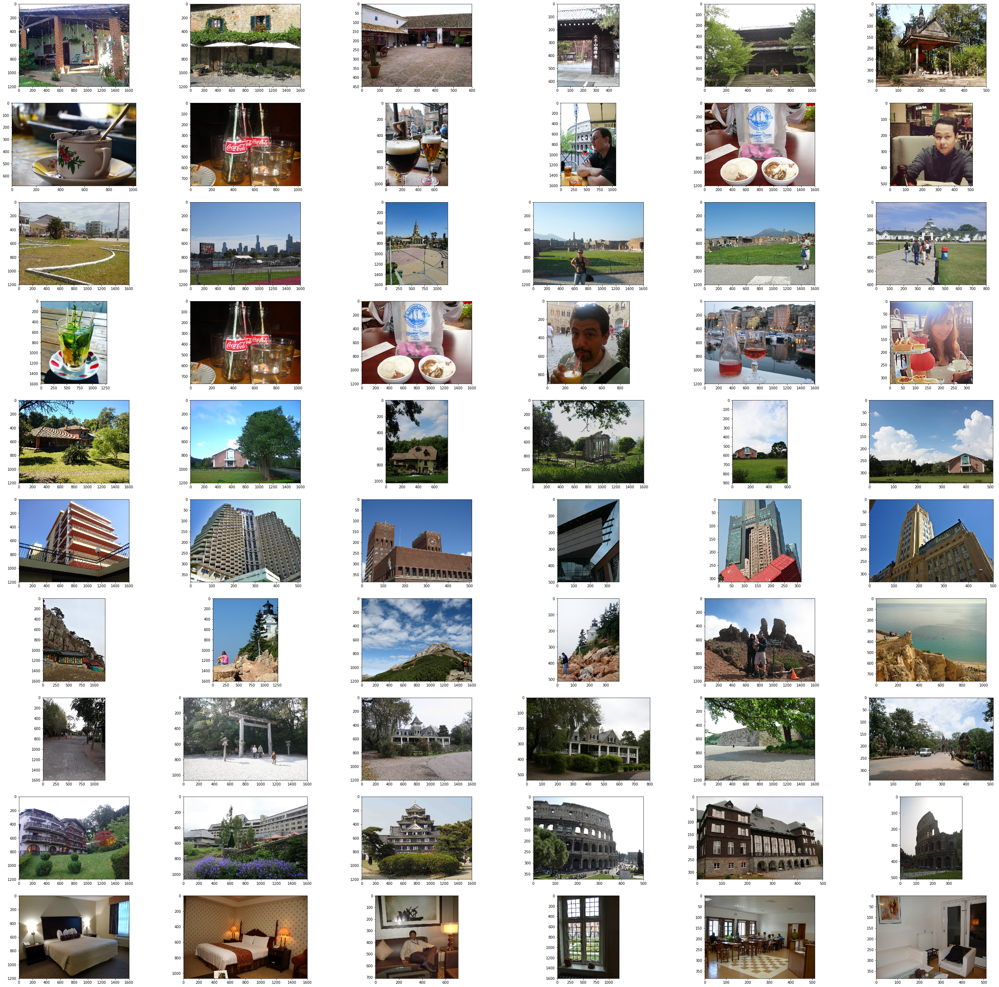

In [7]:
import numpy as np
import matplotlib.pyplot as plt

w=10
h=10
fig=plt.figure(figsize=(50, 50))
columns = EXAMPLE_NUM+1
rows = SAMPLE_NUM
for i in range(1, columns*rows +1):
    response = requests.get(urls_lst[i-1])
    img = Image.open(BytesIO(response.content))
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
plt.show()

# Knn closest Landmarks

In [8]:
import random
import operator


#all_query = list(predict_data.keys())
#rand_indx = random.randint(0, len(all_query)-SAMPLE_NUM-1)
sample_query = all_query[rand_indx:rand_indx+SAMPLE_NUM]

urls_lst = []

uniq_land = {}
for query in sample_query:
    uniq_land = {}
    im_lst = predict_data[query]
    for im in im_lst:
        if(uniq_land.get(train_lb[im])):
            uniq_land[train_lb[im]] += 1
        else:
            uniq_land[train_lb[im]] = 1
    
    sorted_land = sorted(uniq_land.items(), key=operator.itemgetter(1))
    sorted_land.reverse()
    sorted_land = sorted_land[:EXAMPLE_NUM]
    
    urls_lst.append(query_url[query])
    train_urls = [train_data[label_data[l_id[0]][0]] for l_id in sorted_land]
    urls_lst.extend(train_urls)

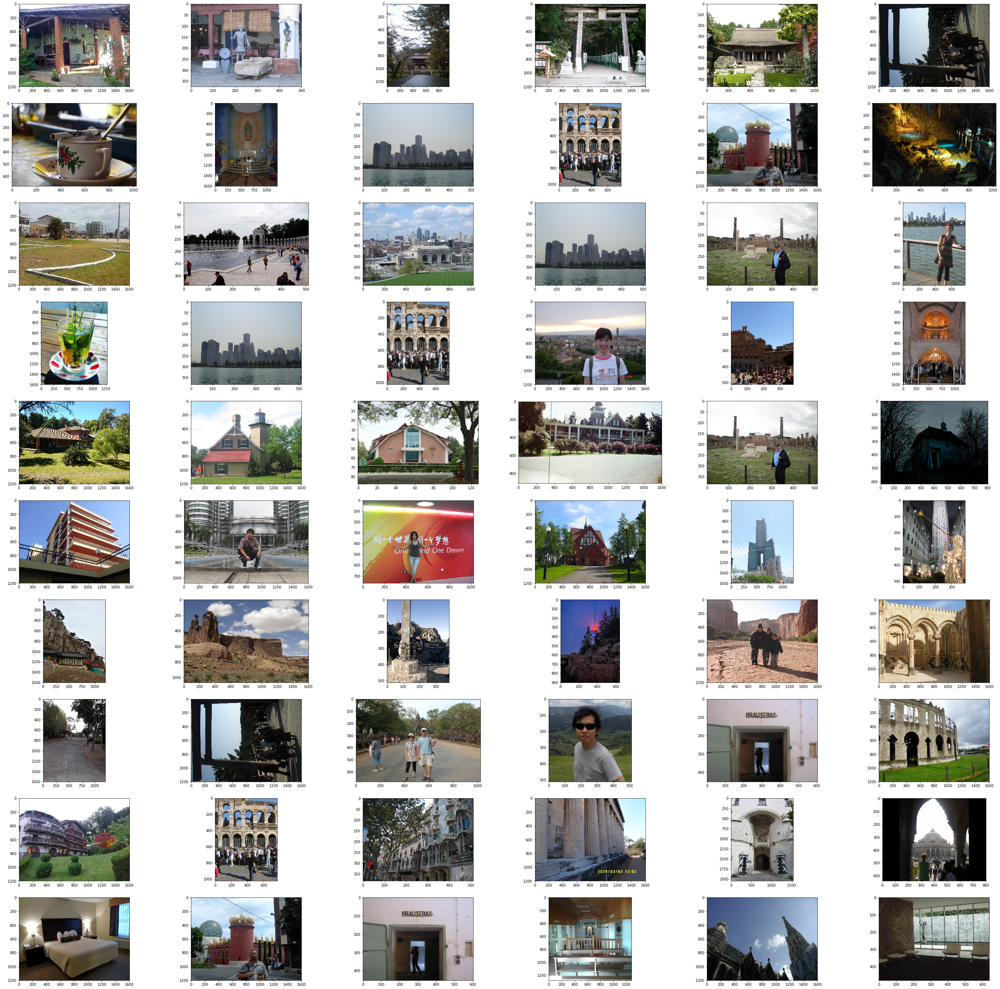

In [9]:
import numpy as np
import matplotlib.pyplot as plt

w=10
h=10
fig=plt.figure(figsize=(50, 50))
columns = EXAMPLE_NUM+1
rows = SAMPLE_NUM
for i in range(1, columns*rows +1):
    response = requests.get(urls_lst[i-1])
    img = Image.open(BytesIO(response.content))
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
plt.show()